In [2]:
import os
import pandas as pd
import seaborn as sns

In [3]:
ss = pd.read_csv('Seattle_Streets.csv')
parking = pd.read_csv('Annual_Parking_Study_Data.csv')

/home/anushnap/anaconda3/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3146: DtypeWarning: Columns (22,23) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [4]:
parking.head()

,Elmntkey,Study_Area,Sub_Area,Date Time,Side,Unitdesc,Peak Hour_SDOT,Parking_Spaces,Total_Vehicle_Count,Dp_Count,...,Idling,Field Notes,Construction,Event Closure,Subarea Label,Study Year,Peak Hour? (Yes or No),RPZ Blocks,CSM,Time Stamp
0,77982.0,South Lake Union,North,9/27/2017 20:00,E,DEXTER AVE N BETWEEN VALLEY ST AND ALOHA ST,NaN,2.0,3.0,NaN,...,NaN,NaN,No,No,South Lake Union (North Subarea),2017.0,No,0.0,Y,09/27/2017 08:38:00 PM
1,35881.0,South Lake Union,North,9/27/2017 20:00,N,VALLEY ST BETWEEN DEXTER AVE N AND 8TH AVE N,NaN,15.0,12.0,1.0,...,NaN,NaN,No,No,South Lake Union (North Subarea),2017.0,No,0.0,Y,09/27/2017 08:36:00 PM
2,8405.0,South Lake Union,North,9/27/2017 20:00,W,8TH AVE N BETWEEN VALLEY ST AND ALOHA ST,NaN,7.0,4.0,NaN,...,NaN,NaN,No,No,South Lake Union (North Subarea),2017.0,No,0.0,Y,09/27/2017 08:36:00 PM
3,8406.0,South Lake Union,North,9/27/2017 20:00,E,8TH AVE N BETWEEN VALLEY ST AND ALOHA ST,NaN,10.0,5.0,NaN,...,NaN,NaN,No,No,South Lake Union (North Subarea),2017.0,No,0.0,Y,09/27/2017 08:36:00 PM
4,8625.0,South Lake Union,North,9/27/2017 20:00,W,9TH AVE N BETWEEN BROAD E ST AND WESTLAKE AVE N,NaN,0.0,0.0,NaN,...,NaN,NaN,No,No,South Lake Union (North Subarea),2017.0,No,0.0,Y,09/27/2017 08:32:00 PM


In [5]:
parking.columns

Index(['Elmntkey', 'Study_Area', 'Sub_Area', 'Date Time', 'Side', 'Unitdesc',
       'Peak Hour_SDOT', 'Parking_Spaces', 'Total_Vehicle_Count', 'Dp_Count',
       'Rpz_Count', 'TG_Car2Go', 'BMW_DN', 'Lime', 'Idling', 'Field Notes',
       'Construction', 'Event Closure', 'Subarea Label', 'Study Year',
       'Peak Hour? (Yes or No)', 'RPZ Blocks', 'CSM', 'Time Stamp'],
      dtype='object')

In [6]:
parking['Study_Area'].value_counts()

South Lake Union                    16679
Belltown                            15306
First Hill                          12546
Pike-Pine                           10567
Uptown                              10264
                                    ...  
Ballard Locks Spring                   39
Ballard Locks summer                   39
Ballard Locks Spring 2017              39
Ballard Locks - Weekday (Spring)       39
Ballard Locks - Weekday (Summer)       39
Name: Study_Area, Length: 75, dtype: int64

<AxesSubplot:xlabel='Date Time', ylabel='Parking_Spaces'>

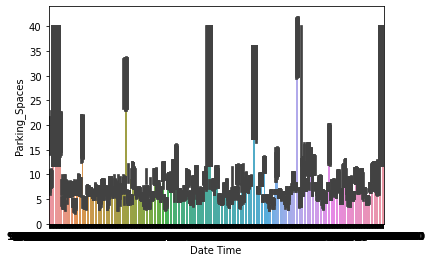

In [7]:
sns.barplot(x = 'Date Time', y = 'Parking_Spaces', data = parking)

In [8]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [9]:
col = parking['Date Time'].str.split(expand = True)
parking['24H'] = col[1]
parking['24H']

0            20:00
1            20:00
2            20:00
3            20:00
4            20:00
5            20:00
6            20:00
7            20:00
8            20:00
9            20:00
10           20:00
11           20:00
12           20:00
13           20:00
14           20:00
15           20:00
16           20:00
17           20:00
18           20:00
19           20:00
20           20:00
21           20:00
22           20:00
23           20:00
24           20:00
25           20:00
26           20:00
27           20:00
28           20:00
29           20:00
30           20:00
31           20:00
32           20:00
33           20:00
34           20:00
35           20:00
36           20:00
37           20:00
38           20:00
39           20:00
40           20:00
41           20:00
42           20:00
43           20:00
44           20:00
45           20:00
46           20:00
47           20:00
48           20:00
49           20:00
50           20:00
51           20:00
52          

In [10]:
parking.groupby('24H')['Parking_Spaces'].agg([len, sum, min, max])

,len,sum,min,max
24H,,,,
00:00:00,26.0,0.0,NaN,NaN
0:00,609.0,4008.0,0.0,31.0
10:00,11726.0,86222.0,0.0,120.0
11:00,11726.0,86216.0,0.0,120.0
12:00,11726.0,86213.0,0.0,120.0
13:00,11726.0,86223.0,0.0,120.0
14:00,11725.0,86134.0,0.0,120.0
15:00,11726.0,82100.0,0.0,120.0
16:00,11726.0,80744.0,0.0,120.0


In [11]:
parking.groupby('24H')['Parking_Spaces'].count()

24H
00:00:00        0
0:00          607
10:00       11707
11:00       11705
12:00       11708
13:00       11708
14:00       11706
15:00       11707
16:00       11707
17:00       11707
18:00       11706
19:00       11658
1:00           95
20:00       11588
21:00        7920
22:00        4745
23:00        1952
2:00           95
7:00           70
8:00        11704
9:00        11706
Name: Parking_Spaces, dtype: int64

In [12]:
parking['Study_Area'].value_counts()

South Lake Union                    16679
Belltown                            15306
First Hill                          12546
Pike-Pine                           10567
Uptown                              10264
Commercial Core                      8168
Ballard                              7614
Pioneer Square                       6775
University District                  6697
Chinatown/ID                         6456
Capitol Hill                         5068
Denny Triangle                       3922
Fremont                              2690
Belltown - Weekday                   2386
Roosevelt                            2295
First Hill - Weekday                 2250
Uptown Triangle                      2217
South Lake Union - Weekday           2002
Pike-Pine - Weekday                  1843
Commercial Core - Weekday            1829
Pioneer Square - Sunday              1781
Westlake                             1776
Columbia City                        1765
Green Lake                        

In [13]:
areas = parking['Study_Area'].str.split('-', expand = True)
areas

,0,1,2
0,South Lake Union,None,None
1,South Lake Union,None,None
2,South Lake Union,None,None
3,South Lake Union,None,None
4,South Lake Union,None,None
5,South Lake Union,None,None
6,South Lake Union,None,None
7,South Lake Union,None,None
8,South Lake Union,None,None
9,South Lake Union,None,None


In [14]:
parking['Area'] = areas[0].str.strip()
parking['Sub-Area'] = areas[1] + "-" + areas[2]

In [15]:
parking['Area'].value_counts()

South Lake Union              18681
Belltown                      17692
First Hill                    14796
Commercial Core               12543
Pike                          12410
Uptown                        12291
Pioneer Square                11234
Chinatown/ID                   9844
Ballard                        8718
University District            7451
Capitol Hill                   5916
Denny Triangle                 5248
Fremont                        3234
Roosevelt                      2685
Uptown Triangle                2646
Green Lake                     2331
Westlake                       1984
Denny Triangle North           1911
Columbia City                  1765
Cherry Hill                    1611
Pioneer Square 2017            1495
Greenlake                      1392
Commercial Core Retail         1200
Chinatown ID 2017              1140
SODO                            871
12th Avenue                     793
Denny Triangle South            705
West Seattle                

In [21]:
parking.groupby('Area')['Unitdesc'].nunique()

Area
12th Ave                        7
12th Ave 2017 Annual Study     13
12th Avenue                     7
15th Avenue                     8
Ballard                        59
Ballard Locks                   2
Ballard Locks Spring            2
Ballard Locks Spring 2017       2
Ballard Locks Summer            2
Ballard Locks summer            2
Belltown                      126
Capitol Hill                   52
Cherry Hill                    18
Chinatown ID 2017              41
Chinatown/ID                   47
Columbia City                  38
Commercial Core               128
Commercial Core Financial      31
Commercial Core Retail         51
Commercial Core Saturday       22
Commercial Core Waterfront     27
Denny Triangle                 66
Denny Triangle North           52
Denny Triangle South           16
Dexter                          8
First Hill                    103
Fremont                        20
Green Lake                     24
Greenlake                      19
Lake City